In [ ]:
from google.colab.patches import cv2_imshow
from skimage.feature import hog
import csv
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

In [ ]:
folder_path="/content/drive/MyDrive/style[1]"
images=[]
features=[]
folder_list=all
labels=[]
print(folder_list)

<built-in function all>


In [ ]:
img_sizeb=100
img_size=100
for filename in os.listdir(folder_path):
    if filename.endswith(".png") or filename.endswith(".jpg") or filename.endswith(".jpeg"):
        filepath = os.path.join(folder_path, filename)
        image = cv2.imread(filepath)
        r_arr = cv2.resize(image, (img_size, img_size))
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        fd, hog_image = hog(gray, orientations=8, pixels_per_cell=(16, 16), cells_per_block=(1, 1), visualize=True, multichannel=False)
        fd_color = cv2.calcHist([image], [0, 1, 2], None, [8, 8, 8], [0, 256, 0, 256, 0, 256]).flatten()
        fd = np.concatenate((fd, fd_color))
        features.append(fd)
        labels.append(filename)
        images.append(r_arr)

<ipython-input-3-ac35a231b2d2>:9: FutureWarning: `multichannel` is a deprecated argument name for `hog`. It will be removed in version 1.0. Please use `channel_axis` instead.
  fd, hog_image = hog(gray, orientations=8, pixels_per_cell=(16, 16), cells_per_block=(1, 1), visualize=True, multichannel=False)


In [ ]:
max_length = max(len(fd) for fd in features)
features = [np.pad(fd, (0, max_length - len(fd)), mode='constant') for fd in features]
max_length = max(len(fd) for fd in features)
features = [np.pad(fd, (0, max_length - len(fd)), mode='constant') for fd in features]
features = np.array(features)
features = features.reshape(features.shape[0], -1)

In [ ]:
kmeans = KMeans(n_clusters=5, random_state=0).fit(features)

/usr/local/lib/python3.9/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


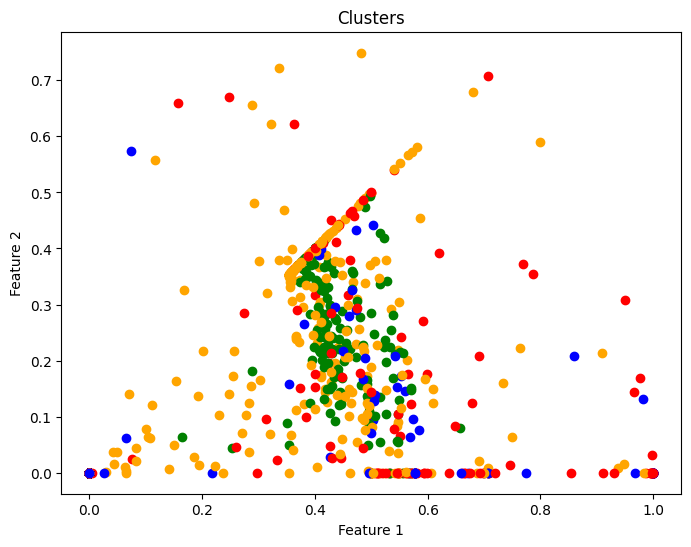

In [ ]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(8, 6))

colors = ['red', 'blue', 'green', 'orange', 'purple']

for i, label in enumerate(kmeans.labels_):
    x = features[i, 0]
    y = features[i, 1]
    ax.scatter(x, y, color=colors[label])

ax.set_title("Clusters")
ax.set_xlabel("Feature 1")
ax.set_ylabel("Feature 2")
plt.show()

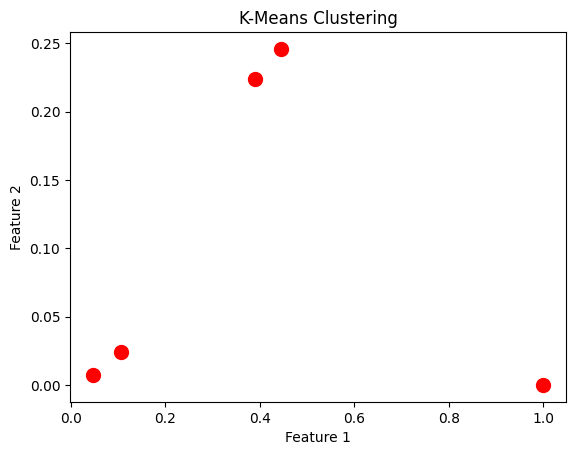

In [ ]:
import matplotlib.pyplot as plt
centroids = kmeans.cluster_centers_
plt.scatter(centroids[:, 0], centroids[:, 1], s=100, c='red')
plt.title('K-Means Clustering')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.show()


In [ ]:
for cluster_id in range(5):
    print(f"Cluster {cluster_id}:")
    cluster_images = [images[i] for i, label in enumerate(kmeans.labels_) if label == cluster_id]
    centroid_features = centroids[cluster_id].reshape(1, -1)
    centroid_label = kmeans.predict(centroid_features)[0]
    centroid_image = [images[i] for i, label in enumerate(kmeans.labels_) if label == centroid_label][0]
    cv2_imshow(centroid_image)
    print('\n')



'for cluster_id in range(5):\n    print(f"Cluster {cluster_id}:")\n    cluster_images = [images[i] for i, label in enumerate(kmeans.labels_) if label == cluster_id]\n    centroid_features = centroids[cluster_id].reshape(1, -1)\n    centroid_label = kmeans.predict(centroid_features)[0]\n    centroid_image = [images[i] for i, label in enumerate(kmeans.labels_) if label == centroid_label][0]\n    cv2_imshow(centroid_image)\n    print(\'\n\')'

Cluster 0:


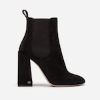

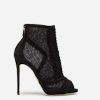

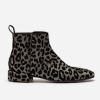

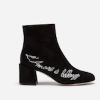

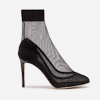

...

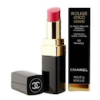

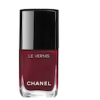

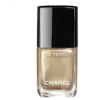

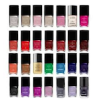

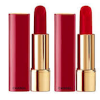



Cluster 1:


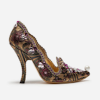

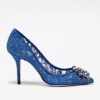

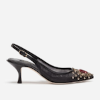

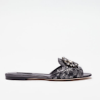

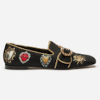

...

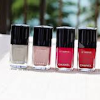

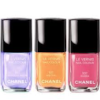

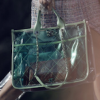

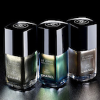

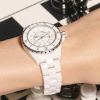



Cluster 4:


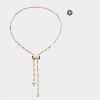

In [ ]:
for cluster_id in range(5):
  print(f"Cluster {cluster_id}:")
  for i, label in enumerate(kmeans.labels_):
    if label == cluster_id:
      cv2_imshow(images[i])
      print('\n')